# Objective of the Project
###  For this challenge, the main objective is to assist the company in improving customer retention by identifying high value customers and churn risks, while being asked to present my findings in a well-written report. 
### Finding the most suited machine learning model for correct classification of Churn and non churn customers.

In [1]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from ydata_profiling import ProfileReport

#### Model Building Liberaries

In [2]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn import svm
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression

from sklearn.metrics import accuracy_score
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import recall_score, confusion_matrix, precision_score, f1_score, accuracy_score, classification_report

from sklearn.ensemble import VotingClassifier
from sklearn.metrics import confusion_matrix, accuracy_score 
from sklearn.metrics import f1_score, precision_score, recall_score, fbeta_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import KFold
from sklearn import feature_selection
from sklearn import model_selection
from sklearn import metrics
from sklearn.metrics import classification_report, precision_recall_curve
from sklearn.metrics import auc, roc_auc_score, roc_curve
from sklearn.metrics import make_scorer, recall_score, log_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import RocCurveDisplay
import xgboost
import shap
from lime.lime_tabular import LimeTabularExplainer

In [3]:
df=pd.read_csv('telecom_customer_churn.csv')

In [4]:
df.head()

,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Payment Method,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason
0,0002-ORFBO,Female,37,Yes,0,Frazier Park,93225,34.827662,-118.999073,2,...,Credit Card,65.6,593.30,0.00,0,381.51,974.81,Stayed,NaN,NaN
1,0003-MKNFE,Male,46,No,0,Glendale,91206,34.162515,-118.203869,0,...,Credit Card,-4.0,542.40,38.33,10,96.21,610.28,Stayed,NaN,NaN
2,0004-TLHLJ,Male,50,No,0,Costa Mesa,92627,33.645672,-117.922613,0,...,Bank Withdrawal,73.9,280.85,0.00,0,134.60,415.45,Churned,Competitor,Competitor had better devices
3,0011-IGKFF,Male,78,Yes,0,Martinez,94553,38.014457,-122.115432,1,...,Bank Withdrawal,98.0,1237.85,0.00,0,361.66,1599.51,Churned,Dissatisfaction,Product dissatisfaction
4,0013-EXCHZ,Female,75,Yes,0,Camarillo,93010,34.227846,-119.079903,3,...,Credit Card,83.9,267.40,0.00,0,22.14,289.54,Churned,Dissatisfaction,Network reliability


In [5]:
df.tail()

,Customer ID,Gender,Age,Married,Number of Dependents,City,Zip Code,Latitude,Longitude,Number of Referrals,...,Payment Method,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Customer Status,Churn Category,Churn Reason
7038,9987-LUTYD,Female,20,No,0,La Mesa,91941,32.759327,-116.997260,0,...,Credit Card,55.15,742.90,0.0,0,606.84,1349.74,Stayed,NaN,NaN
7039,9992-RRAMN,Male,40,Yes,0,Riverbank,95367,37.734971,-120.954271,1,...,Bank Withdrawal,85.10,1873.70,0.0,0,356.40,2230.10,Churned,Dissatisfaction,Product dissatisfaction
7040,9992-UJOEL,Male,22,No,0,Elk,95432,39.108252,-123.645121,0,...,Credit Card,50.30,92.75,0.0,0,37.24,129.99,Joined,NaN,NaN
7041,9993-LHIEB,Male,21,Yes,0,Solana Beach,92075,33.001813,-117.263628,5,...,Credit Card,67.85,4627.65,0.0,0,142.04,4769.69,Stayed,NaN,NaN
7042,9995-HOTOH,Male,36,Yes,0,Sierra City,96125,39.600599,-120.636358,1,...,Bank Withdrawal,59.00,3707.60,0.0,0,0.00,3707.60,Stayed,NaN,NaN


In [6]:
#Using pandas_profiling to have a holistic view of the dataset
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
#Converting feature names into snake case and removing irrelevant features.
df.rename(lambda x: x.lower().strip().replace(' ', '_'), axis='columns', inplace = True)
df.drop(columns = ['customer_id', 'zip_code', 'latitude', 'longitude'], inplace = True)

In [8]:
df.columns

Index(['gender', 'age', 'married', 'number_of_dependents', 'city',
       'number_of_referrals', 'tenure_in_months', 'offer', 'phone_service',
       'avg_monthly_long_distance_charges', 'multiple_lines',
       'internet_service', 'internet_type', 'avg_monthly_gb_download',
       'online_security', 'online_backup', 'device_protection_plan',
       'premium_tech_support', 'streaming_tv', 'streaming_movies',
       'streaming_music', 'unlimited_data', 'contract', 'paperless_billing',
       'payment_method', 'monthly_charge', 'total_charges', 'total_refunds',
       'total_extra_data_charges', 'total_long_distance_charges',
       'total_revenue', 'customer_status', 'churn_category', 'churn_reason'],
      dtype='object')

In [9]:
df.avg_monthly_long_distance_charges=df.avg_monthly_long_distance_charges.fillna(0.0)

In [10]:
df.multiple_lines=df.multiple_lines.fillna('no phone service')

In [11]:
no_internet=['internet_type','online_security','online_backup','device_protection_plan','premium_tech_support','streaming_tv',
             'streaming_movies','streaming_music','unlimited_data']
df[no_internet]=df[no_internet].fillna('no internet service')

In [12]:
df.avg_monthly_gb_download=df.avg_monthly_gb_download.fillna(0.0)

[Text(0.5, 0, ''), Text(0, 0.5, '')]

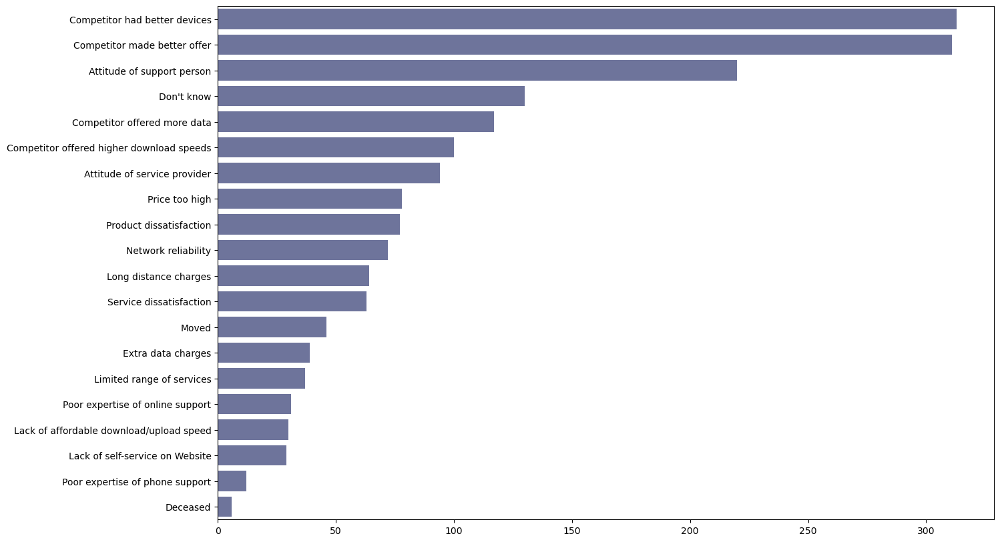

In [13]:
#Identify Causes for Churning
fig = plt.figure(figsize = (15, 10))
ax = sns.countplot(data = df, y = df['churn_reason'], order = df['churn_reason'].value_counts().index, color = '#676FA3')
ax.set(xlabel = None, ylabel = None)

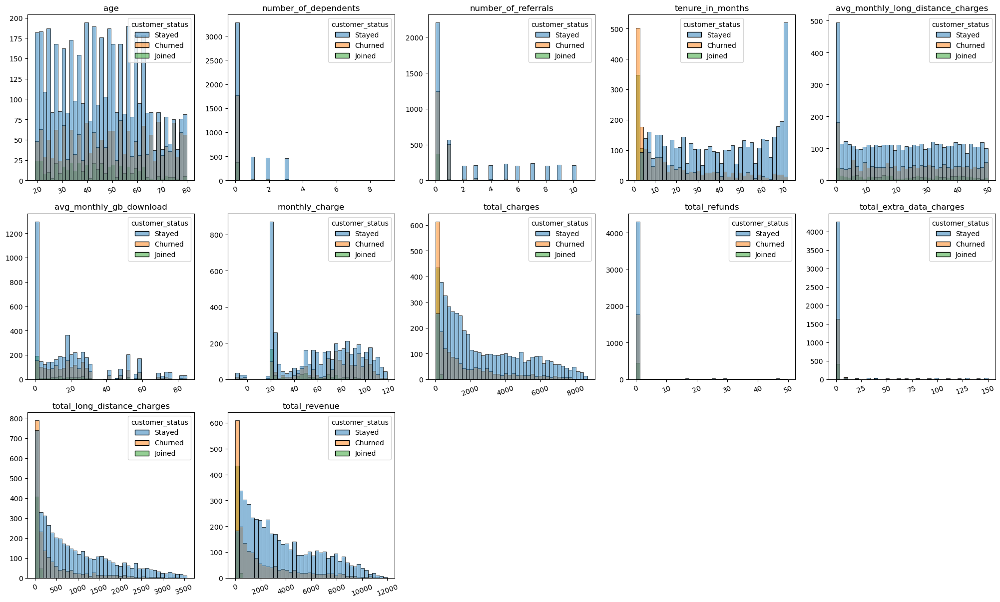

In [14]:
num = [cname for cname in df.columns if df[cname].dtype in ['int64', 'float64']]
df_num = df[num]

fig = plt.figure(figsize = (25, 25))

i = 1
for n in df_num.columns:
    plt.subplot(5, 5, i)
    ax = sns.histplot(x = df[n], hue = df['customer_status'], bins = 40)
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(n), loc = 'center')
    plt.xticks(rotation = 20, fontsize = 10)
    i += 1

## Insights <br>
- **tenure_in_months:**  Customer churn rate is highest within the first few months (5) of subscribing to the service.<br>
- **total_charges and revenue:** In relation to their short duration of subscription, total amount charged to churned customers are relatively low compared to those who stayed, hence, lower revenue garnered.

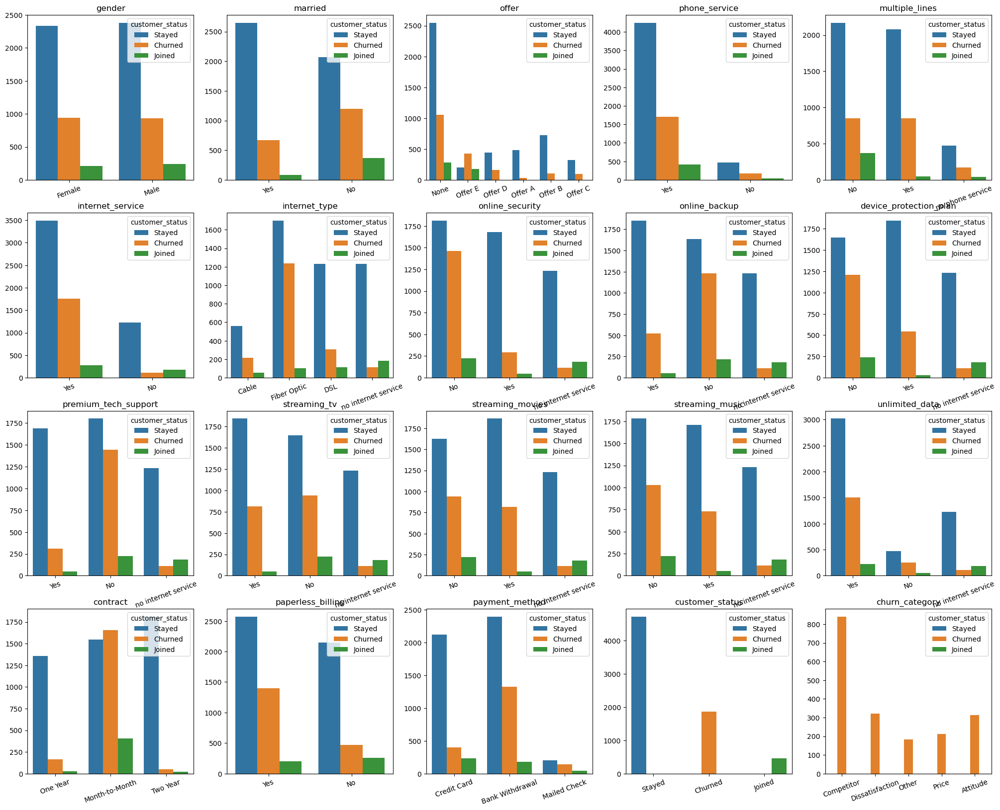

In [15]:
cat = [name for name in df.columns if df[name].nunique() < 10 and df[name].dtype == "object"]
df_cat = df[cat]

fig = plt.figure(figsize = (25, 25))

i = 1
for c in df_cat.columns:
    plt.subplot(5, 5, i)
    ax = sns.countplot(data = df_cat, x = df_cat[c], hue = 'customer_status')
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(c), loc='center')
    plt.xticks(rotation = 20, fontsize = 10)
    i += 1

## Insights:



**PhoneService:** As expected, Majority of people have phone lines. <br> <br>

**MultipleLines :** To be honest, I didn't see that coming. I thought that a large percentage of people would have only one phone line, but it seems that there is a very small gap between people who have and haven't multiple lines.<br> <br>

**InternetService:** Most of people use Fiber optics categories, but the gap isn't that big.
There are 1214 people that don't have internet service. I think this suggests that the company is much famous for phoneline services.<br> <br>

**OnlineSecurity & OnlineProtection & OnlineBackup & TechSupport:** A big percentage of people don't enjoy those services.

**StreamingTV & StreamingMovies:** Number of people who have this service is close to the number of people who haven't. I think most of our insights suggests that this company is famous for phone line service more the internet. <br> <br>

 
***A person has of has't phone service, It won't change much either if he has multiple lines or if he hasn't.
If a person doesn't have internet service, he is more likely not to churn.
Having online Backup & online security & Device protection & Tech support increases the probability that the person won't churn.***


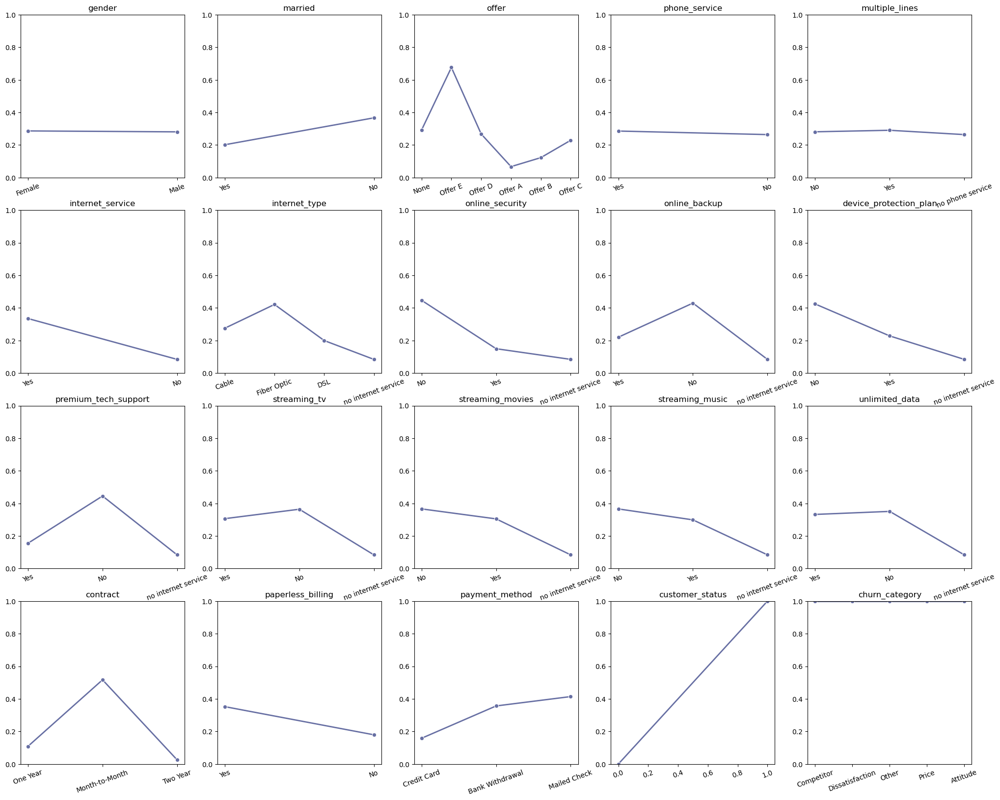

In [16]:
dfc = df.loc[df.customer_status != 'Joined']
dfc.loc[dfc.customer_status == 'Stayed', 'customer_status'] = 0
dfc.loc[dfc.customer_status == 'Churned', 'customer_status'] = 1
dfc_cat = dfc[cat]
dfc_num = dfc[num]


fig = plt.figure(figsize = (25, 25))

i = 1
for c in dfc_cat.columns:
    plt.subplot(5, 5, i)
    ax = sns.lineplot(data = dfc_cat, x = dfc_cat[c], y= dfc_cat['customer_status'].astype('float'), linewidth = 2, marker = 'o', ci = None, color = '#676FA3')
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(c), loc='center')
    plt.ylim(0, 1)
    plt.xticks(rotation = 20, fontsize = 10)
    i += 1

## Insights
**offer:** Most customers didn't accept marketing offers. The marketing team may want to improve on this low conversion rate. Unfortunately, no information were provided about the complete details of each offer, although we do observe high customer churn rate after subscribing to Offer E. <br> <br>
**internet_service:** Higher churn rate with subscriptions to internet service. Anecdotally, there are several causes related to internet services that can lead to customer dissatisfaction. One of the most frequent examples include slow internet conncetion.<br><br>
**internet_type:** Of the various internet connection types, Fiber Optic is the most popular, for it had the fastest download and upload speeds compared to cable and DSL at the expense of higher prices. However, Fiber Optic users are also the most likely to discontinue the connection service. <br><br>
**contract:** It makes sense that contracts set for longer timeframes either up to one or two years discourage the subscribers to discontinue their service. On the contrary, users are likely to churn if they opt to pay at a monthly basis.
Subsribing to any of the additional internet services (i.e. online security, backup, device protection plan, etc.) appears to considerably reduce the customer churn rate by a certain percentage.

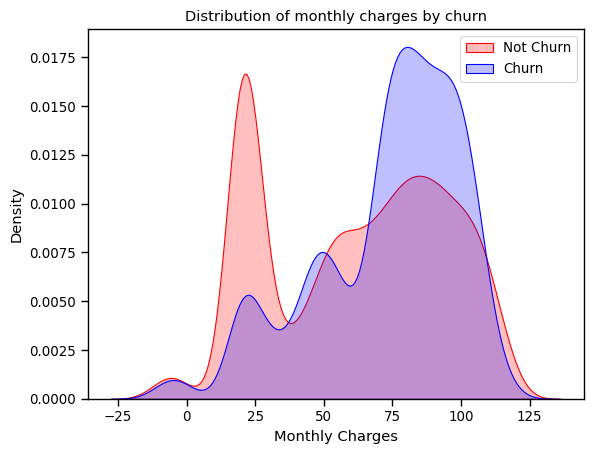

In [17]:
sns.set_context("paper",font_scale=1.1)
ax = sns.kdeplot(df.monthly_charge[(df["customer_status"]== 'Stayed')],
                color="Red", shade = True);
ax = sns.kdeplot(df.monthly_charge[(df["customer_status"]== 'Churned')],
                ax =ax, color="Blue", shade= True);
ax.legend(["Not Churn","Churn"],loc='upper right');
ax.set_ylabel('Density');
ax.set_xlabel('Monthly Charges');
ax.set_title('Distribution of monthly charges by churn');

- Customers with higher Monthly Charges are also more likely to churn

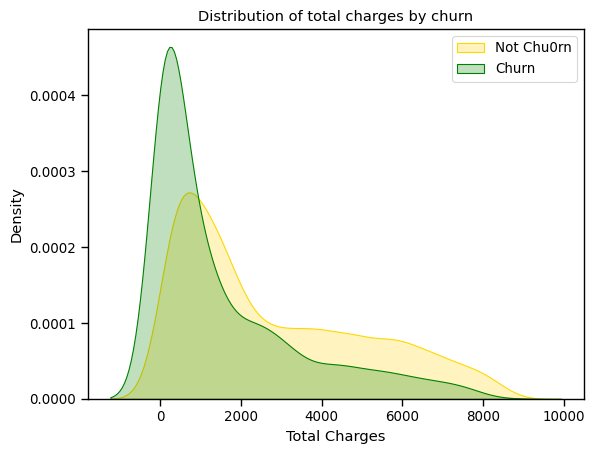

In [18]:
ax = sns.kdeplot(df.total_charges[(df["customer_status"]== 'Stayed')],
                color="Gold", shade = True);
ax = sns.kdeplot(df.total_charges[(df["customer_status"]== 'Churned')],
                ax =ax, color="Green", shade= True);
ax.legend(["Not Chu0rn","Churn"],loc='upper right');
ax.set_ylabel('Density');
ax.set_xlabel('Total Charges');
ax.set_title('Distribution of total charges by churn');

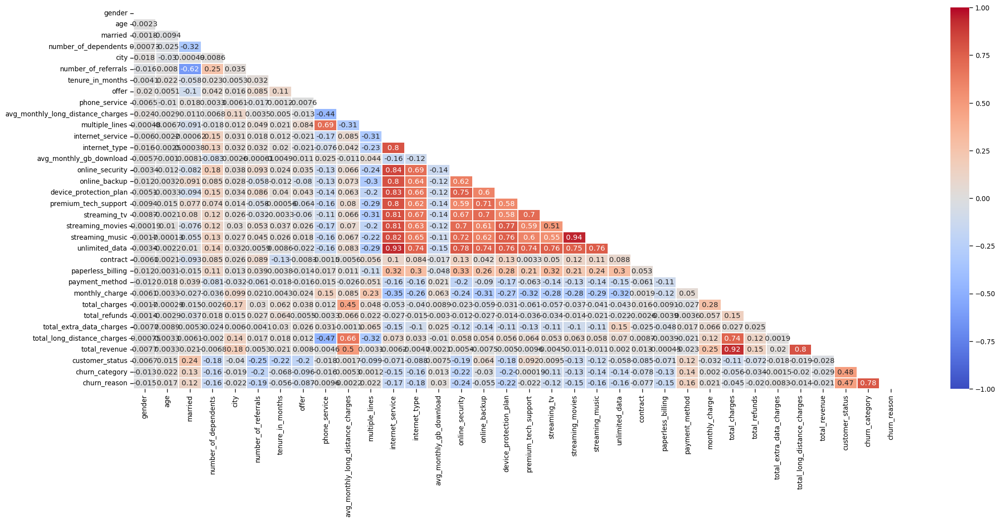

In [19]:
plt.figure(figsize=(25, 10))

corr = df.apply(lambda x: pd.factorize(x)[0]).corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

ax = sns.heatmap(corr, mask=mask, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, linewidths=.2, cmap='coolwarm', vmin=-1, vmax=1)

##    Big Spenders Customers vs Churned Customers

Customers who contributed more than the average revenue will be regarded as Big Spenders.

In [20]:
dfv=df.copy()
dfv['big_spender'] = 0
dfv.loc[ df['total_revenue'] >= dfv['total_revenue'].mean() , 'big_spender'] = 1

Customers whose had more than or equal to 2 referrals will be regarded as **WORD OF MOUTH Marketers** 

In [21]:
dfv['wom'] = 0
dfv.loc[ df['number_of_referrals'] >= 2 , 'wom'] = 1

Customers are **loyal** if they have stayed for more than the average tenure of all customers.

In [22]:
dfv['loyal'] = 0
dfv.loc[ (dfv['tenure_in_months'] >= dfv['tenure_in_months'].mean()) & (dfv['customer_status'] == 'Stayed') , 'loyal'] = 1

In [23]:
high_value = dfv[['big_spender', 'wom', 'loyal']]
high_value.head()

,big_spender,wom,loyal
0,0,1,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,1,0


In [24]:
highvalue_rev=dfv[(dfv.big_spender == 1) & (dfv.wom == 1) & (dfv.loyal == 1)]['total_revenue'].sum()
total_rev=dfv['total_revenue'].sum()
percent=(highvalue_rev/total_rev)*100
print(percent,'% of revenue is contributed by high-value customers who are big spenders, wom marketers, and loyal.')


33.74313697844234 % of revenue is contributed by high-value customers who are big spenders, wom marketers, and loyal.


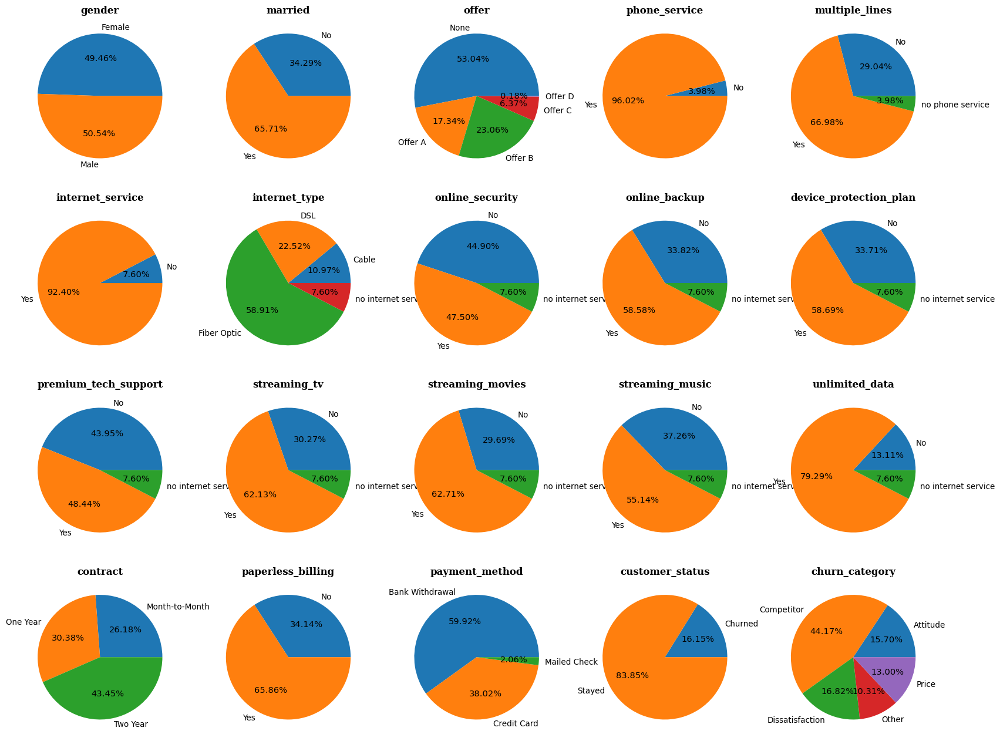

In [25]:
cat = [cname for cname in dfv.columns if dfv[cname].nunique() < 10 and dfv[cname].dtype == "object" ]
_ = df[cat]
df_big_spender = dfv[dfv.big_spender == 1]

fig = plt.figure(figsize = (20, 20))

i = 1
for c in _.columns:
    plt.subplot(5, 5, i)
    ax = df_big_spender.groupby([c]).size().plot(kind = 'pie', autopct = '%.2f%%')
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(c), loc='center', font = 'serif', fontweight = 'bold', fontsize = 12)
    i += 1

## Insights about  Big Spenders
- Approximately 2/3 of the customers are married.
- Around half of the customers indulged marketing offers by the company with the exception of Offer E.
- Almost 2/3 are subscribed to Fiber Optic, known for its fast connection speeds at the cost of higher expenses.
- 2x more likely to enjoy additional internet services such as online backup, protection plan, and other streaming related services.
- 3x more likely to subscribe to long term contracts over settling payments at a month-to-month basis.
- It is unfortunate that 16.15% of big spenders have churned, mostly due to the more attractive offers from competitors.

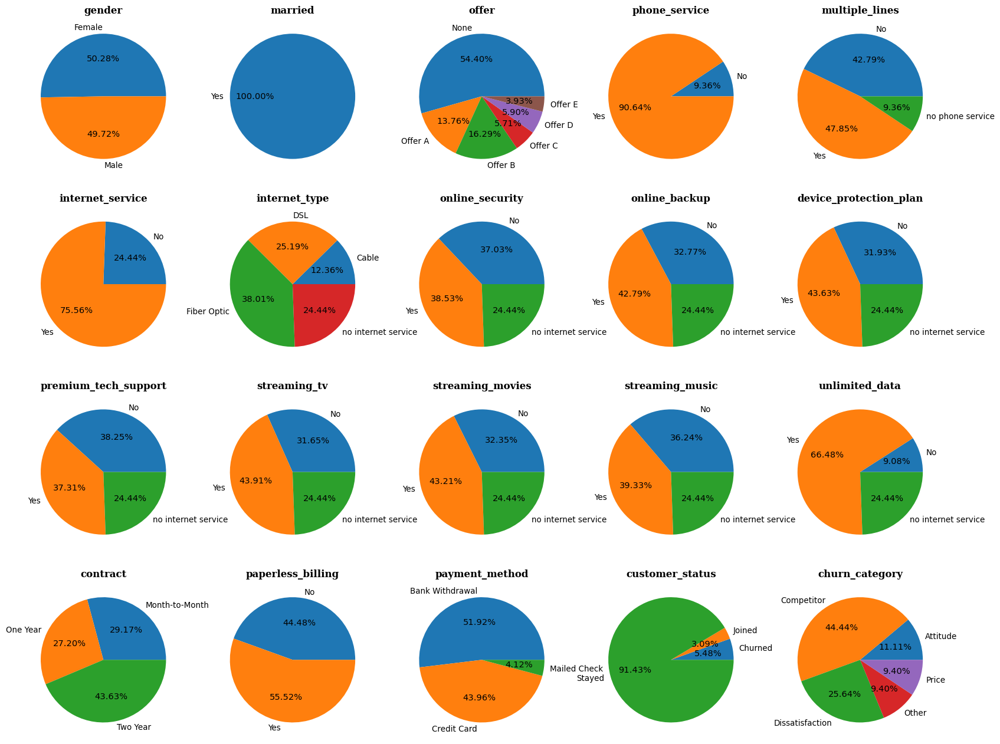

In [26]:
cat = [cname for cname in dfv.columns if dfv[cname].nunique() < 10 and dfv[cname].dtype == "object"]
_ = dfv[cat]
df_wom = dfv[dfv.wom == 1]

fig = plt.figure(figsize = (20, 20))

i = 1
for c in _.columns:
    plt.subplot(5, 5, i)
    ax = df_wom.groupby([c]).size().plot(kind = 'pie', autopct = '%.2f%%')
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(c), loc='center', font = 'serif', fontweight = 'bold', fontsize = 12)
    i += 1

## Insights about WOM Marketers
- All customers are married.
- Offer E appears to have been enjoyed by a very small percentage of this customer group, which isn't a thing for Big Spenders.
- Over half are Fiber Optic users.
- Likewise big spenders, they also enjoy additional internet services such as online backup, protection plan, and other streaming related services (excluding streaming music).
- 5.48% have churned while 3.09% are newcomers.

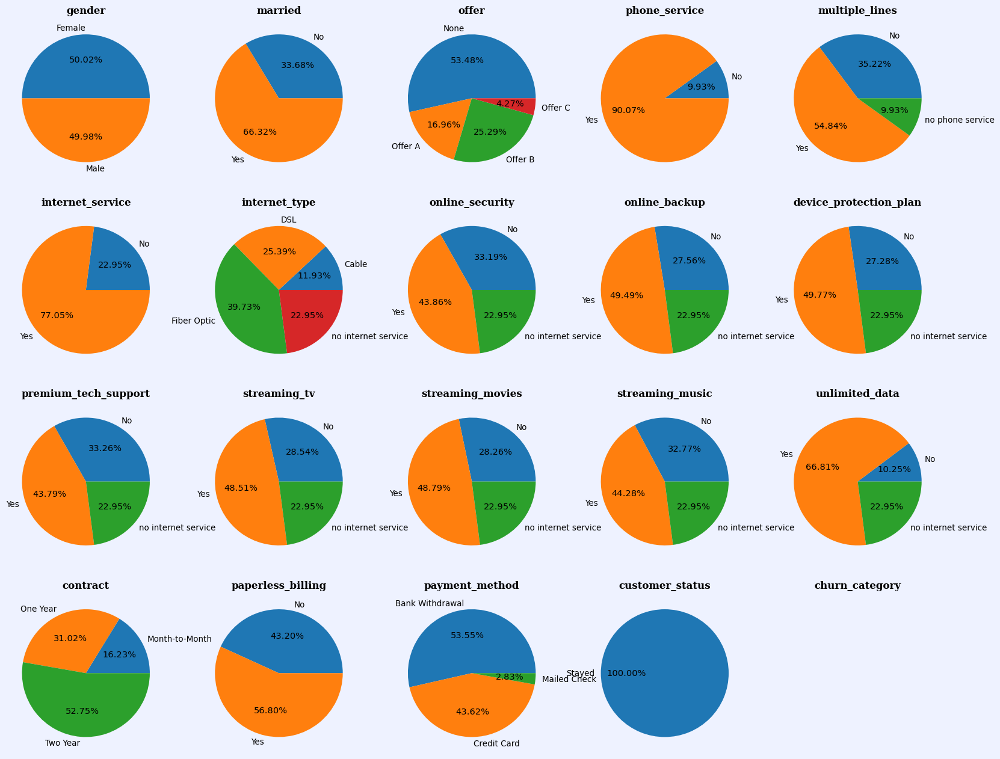

In [27]:
cat = [cname for cname in dfv.columns if dfv[cname].nunique() < 10 and dfv[cname].dtype == "object"]
_ = dfv[cat]
df_loyal = dfv[dfv.loyal == 1]

fig = plt.figure(figsize = (20, 20), facecolor = '#EEF2FF')

i = 1
for c in _.columns:
    plt.subplot(5, 5, i)
    ax = df_loyal.groupby([c]).size().plot(kind = 'pie', autopct = '%.2f%%')
    ax.set(xlabel = None, ylabel = None)
    plt.title(str(c), loc='center', font = 'serif', fontweight = 'bold', fontsize = 12)
    i += 1

## Insights about Loyal Customers
- Only Offers A, B, and C were accepted by these users.
- Over half are Fiber Optic users.
- Almost 2x more likely to subsribe to internet services such as online backup, protection plan, and other streaming related services.

### Assessment of the Customer Groups

**High Value Customers Profile**
- **67.73%** are married.
- They haven't purchased **Offer E.**
- More than half of these customers have subscribed to additional **internet services** (i.e. backup, security, protection plan, tech support) and **streaming services** (TV, movies, music).
- Out of the **81.66%** who are subsribed to long term contracts, **50.39%** opted for the two-year contract, and the remaining **31.27%** went for one year.

**Churned Customers Profile**
- Only **35.79%** are married.
- **Offer E** appears to be the most popular offer around churned customers. Perhaps the company may want to review and look for potential pain points about this offer. 
- More than half of churned customers haven't subscribed to additional **internet services** and **streaming services**.
-  **88.55%** choose to pay their bills at a monthly basis.

**What they have in common?**
- Equal distribution in terms of gender.
- **Fiber optic** internet service is popular among both customer groups.
- Majority enjoy **unlimited data.**
- Majority prefers to receive **paperless billing** and pay the bills by **bank withdrawal**.

In [28]:
df=df.loc[~df.customer_status.str.contains('Join')]
df.reset_index(drop=True,inplace=True)

## Feature Transformation and Feature Scaling
- Features having two uniques were replaced by 1 and 0.
- Features having more than two uniques were encoded using label encoder
- Continous features were standarized using sk-learn scaler method

In [29]:
df=df.drop(columns=['churn_category','churn_reason','total_refunds','city'])

In [30]:
#Create a label encoder object
le = LabelEncoder()
# Label Encoding will be used for columns with 2 or less unique 

le_count = 0
for col in df.columns[1:]:
    if df[col].dtype == 'object':
        if len(list(df[col].unique())) <= 2:
            le.fit(df[col])
            df[col] = le.transform(df[col])
            le_count += 1
print('{} columns were label encoded.'.format(le_count))

5 columns were label encoded.


In [31]:
df['gender'] = [1 if each == 'Female' else 0 for each in df['gender']]

In [32]:
def encode_data(dataframe):
    if dataframe.dtype == "object":
        dataframe = LabelEncoder().fit_transform(dataframe)
    return dataframe

data = df.apply(lambda x: encode_data(x))
data.head()

,gender,age,married,number_of_dependents,number_of_referrals,tenure_in_months,offer,phone_service,avg_monthly_long_distance_charges,multiple_lines,...,unlimited_data,contract,paperless_billing,payment_method,monthly_charge,total_charges,total_extra_data_charges,total_long_distance_charges,total_revenue,customer_status
0,1,37,1,0,2,9,0,1,42.39,0,...,1,1,1,1,65.6,593.30,0,381.51,974.81,1
1,0,46,0,0,0,9,0,1,10.69,1,...,0,0,0,1,-4.0,542.40,10,96.21,610.28,1
2,0,50,0,0,0,4,5,1,33.65,0,...,1,0,1,0,73.9,280.85,0,134.60,415.45,0
3,0,78,1,0,1,13,4,1,27.82,0,...,1,0,1,0,98.0,1237.85,0,361.66,1599.51,0
4,1,75,1,0,3,3,0,1,7.38,0,...,1,0,1,1,83.9,267.40,0,22.14,289.54,0


### Splitting the Dataset into test and train

In [33]:
X = data.drop(columns = "customer_status")
y = data["customer_status"].values

In [34]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 4, stratify =y)

In [35]:
df.columns

Index(['gender', 'age', 'married', 'number_of_dependents',
       'number_of_referrals', 'tenure_in_months', 'offer', 'phone_service',
       'avg_monthly_long_distance_charges', 'multiple_lines',
       'internet_service', 'internet_type', 'avg_monthly_gb_download',
       'online_security', 'online_backup', 'device_protection_plan',
       'premium_tech_support', 'streaming_tv', 'streaming_movies',
       'streaming_music', 'unlimited_data', 'contract', 'paperless_billing',
       'payment_method', 'monthly_charge', 'total_charges',
       'total_extra_data_charges', 'total_long_distance_charges',
       'total_revenue', 'customer_status'],
      dtype='object')

In [36]:
def distplot(feature, frame, color='r'):
    plt.figure(figsize=(8,3))
    plt.title("Distribution for {}".format(feature))
    ax = sns.distplot(frame[feature], color= color)

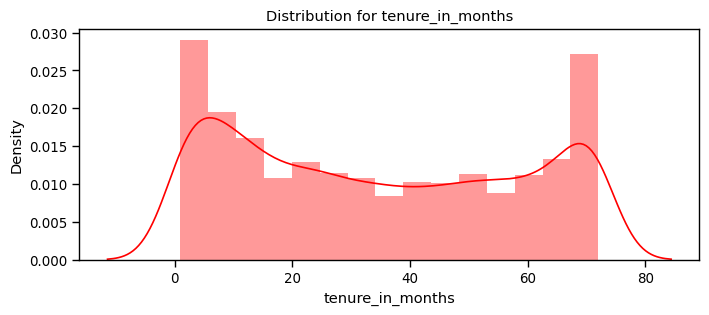

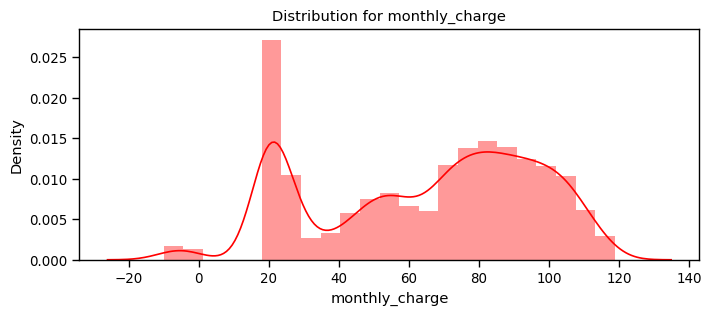

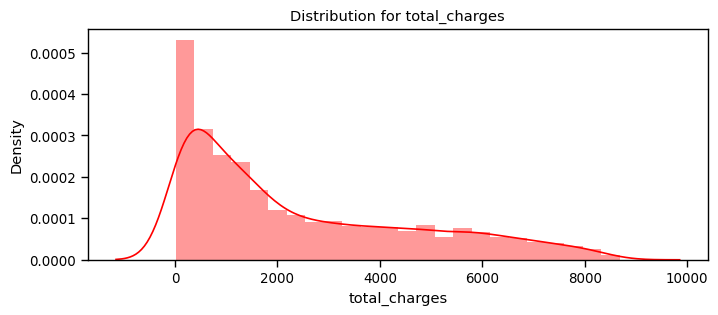

In [37]:
num_cols = ["tenure_in_months", 'monthly_charge', 'total_charges']
for feat in num_cols: distplot(feat, df)

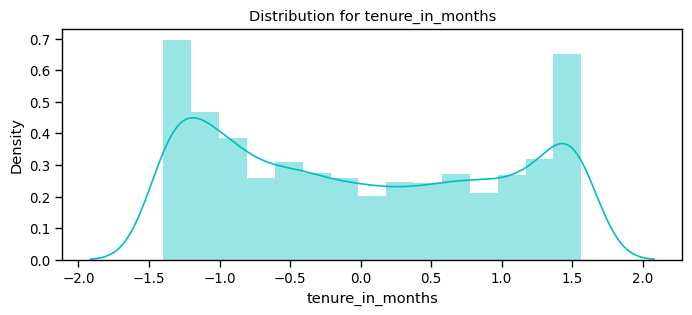

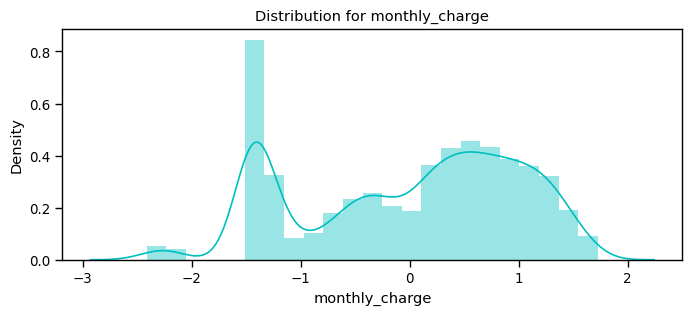

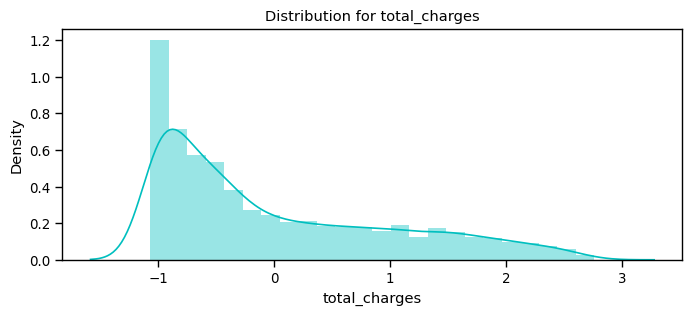

In [38]:
df_std = pd.DataFrame(StandardScaler().fit_transform(df[num_cols].astype('float64')),
                       columns=num_cols)
for feat in num_cols: distplot(feat, df_std, color='c')

In [39]:
# Divide the columns into 3 categories, one ofor standardisation, one for label encoding and one for one hot encoding

cat_cols_ohe =['Payment_Method', 'Contract', 'Internet_Service'] # those that need one-hot encoding
cat_cols_le = list(set(X_train.columns)- set(num_cols) - set(cat_cols_ohe)) #those that need label encoding

In [40]:
scaler= StandardScaler()

X_train[num_cols] = scaler.fit_transform(X_train[num_cols])
X_test[num_cols] = scaler.transform(X_test[num_cols])

Model Building Without Optimization
Since its a binary Classification Problem. So I have tried to build several classification models
At first i have just used the base models and have evaluated them to check how they are pwrforming

In [41]:
models = []
models.append(('Logistic Regression', LogisticRegression()))
models.append(('Kernel SVM', SVC()))
models.append(('Gaussian NB', GaussianNB()))
models.append(('Random Forest', RandomForestClassifier()))
models.append(('Decision Tree Classifier', DecisionTreeClassifier()))

In [42]:
acc_results =[]
auc_results =[]
pre_results =[]
f1_results =[]
names = []

result_col = ["Algorithm", "ROC AUC", "Accuracy", "Precision", "f1 Score"]
model_results = pd.DataFrame(columns = result_col)

i=0
# K- fold cross validation

for name, model in models:
    names.append(name)
    # kfold = model_selection.KFold(n_splits=10)
    
    cv_acc_results = model_selection.cross_val_score(model, X_train, y_train, 
                     scoring="accuracy")
    cv_auc_results = model_selection.cross_val_score(model, X_train, y_train,
                     scoring="roc_auc")
    cv_pre_results = model_selection.cross_val_score(model, X_train, y_train,
                     scoring="precision")
    cv_f1_results = model_selection.cross_val_score(model, X_train, y_train,
                     scoring="f1")
    acc_results.append(cv_acc_results)
    auc_results.append(cv_auc_results)
    pre_results.append(cv_pre_results)
    f1_results.append(cv_f1_results)
    
    model_results.loc[i] = [name, 
                           round(cv_acc_results.mean()*100,2),
                           round(cv_auc_results.mean()*100,2),
                           round(cv_pre_results.mean()*100,2),
                           round(cv_f1_results.mean()*100,2)]
    i+=1

model_results.sort_values(by = ['ROC AUC'], ascending=False)

,Algorithm,ROC AUC,Accuracy,Precision,f1 Score
3,Random Forest,86.47,92.00,88.10,91.28
4,Decision Tree Classifier,81.42,77.66,87.25,87.01
0,Logistic Regression,79.53,85.20,84.28,86.01
2,Gaussian NB,76.71,86.25,91.30,82.10
1,Kernel SVM,76.47,71.18,79.46,84.66


## Finding Good Hyper Parameters on above models indiviually

### Decision Tree Classifier

In [43]:
modelD= DecisionTreeClassifier()
modelD.fit(X_train, y_train)
pred_train_D = modelD.predict(X_train)
pred_test_D=modelD.predict(X_test)
acc_train_D = accuracy_score(pred_train_D, y_train)
acc_test_D = accuracy_score(pred_test_D, y_test)
print(f'Training accuracy {acc_train_D: .3f}') 
print(f'Testing accuracy {acc_test_D: .3f}')

Training accuracy  1.000
Testing accuracy  0.834


In [44]:
tuned_parameters = [{'criterion':['gini', 'entropy'],
                     'max_leaf_nodes': range(5,25)}] # hyperparameters to tune

clf_D = GridSearchCV(DecisionTreeClassifier(), tuned_parameters, 
                   verbose=1, n_jobs=-1) # grid search model
clf_D.fit(X_train, y_train) # evaluate hyper-parameters

print("\nBest parameters found:")
print(clf_D.best_params_) # best hyperparameter balues

print("\nGrid scores:")
means_D = clf_D.cv_results_['mean_test_score'] # mean accuracy with folds
stds_D = clf_D.cv_results_['std_test_score'] # standard deviation of accuracies
# for each hyperparameter combination show mean +/- 2 standard-deviations 
for mean, std, params in zip(means_D, stds_D, clf_D.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" %(mean, std * 2, params))

Fitting 5 folds for each of 40 candidates, totalling 200 fits

Best parameters found:
{'criterion': 'gini', 'max_leaf_nodes': 19}

Grid scores:
0.844 (+/-0.022) for {'criterion': 'gini', 'max_leaf_nodes': 5}
0.851 (+/-0.015) for {'criterion': 'gini', 'max_leaf_nodes': 6}
0.853 (+/-0.010) for {'criterion': 'gini', 'max_leaf_nodes': 7}
0.857 (+/-0.009) for {'criterion': 'gini', 'max_leaf_nodes': 8}
0.857 (+/-0.009) for {'criterion': 'gini', 'max_leaf_nodes': 9}
0.856 (+/-0.010) for {'criterion': 'gini', 'max_leaf_nodes': 10}
0.856 (+/-0.011) for {'criterion': 'gini', 'max_leaf_nodes': 11}
0.856 (+/-0.011) for {'criterion': 'gini', 'max_leaf_nodes': 12}
0.856 (+/-0.015) for {'criterion': 'gini', 'max_leaf_nodes': 13}
0.858 (+/-0.014) for {'criterion': 'gini', 'max_leaf_nodes': 14}
0.859 (+/-0.015) for {'criterion': 'gini', 'max_leaf_nodes': 15}
0.860 (+/-0.020) for {'criterion': 'gini', 'max_leaf_nodes': 16}
0.859 (+/-0.019) for {'criterion': 'gini', 'max_leaf_nodes': 17}
0.859 (+/-0.017)

#### Evaluating Decision Tree classifier with selected hyper-parameters

Based on our 5-fold-cross-validation, we use a model with the following hyper-parameters:

- *criterion* = '*gini*'
- *max_leaf_nodes* = 19

DecisionTreeClassifier(max_leaf_nodes=19)
Results on test data
Test accuracy =  0.8558
Test precision =  0.8641
Test recall =  0.9477
Classification report:
              precision    recall  f1-score   support

           0       0.83      0.62      0.71       561
           1       0.86      0.95      0.90      1416

    accuracy                           0.86      1977
   macro avg       0.84      0.79      0.81      1977
weighted avg       0.85      0.86      0.85      1977

Confusion matrix (Rows actual, Columns predicted):
     0     1
0  350   211
1   74  1342

ROC curve


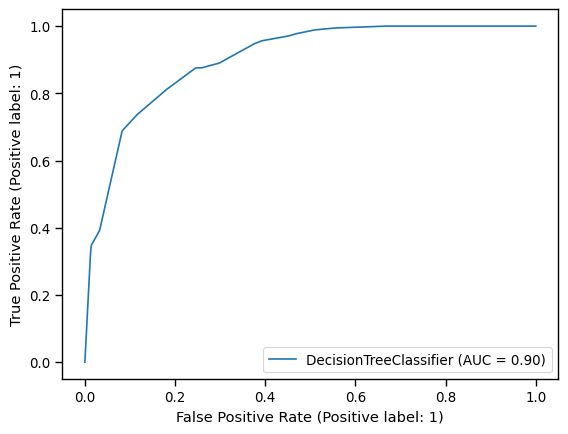

In [45]:
criterion = 'gini'
max_leaf_nodes = 19
# Train and test model
good_model_D = DecisionTreeClassifier(criterion=criterion,
                                    max_leaf_nodes=max_leaf_nodes) # create model 
print(good_model_D) # display model parameters
good_model_D.fit(X_train, y_train) # train model
pred_D = good_model_D.predict(X_test) # predicted output for test examples
print("Results on test data")
acc_D = accuracy_score(y_test, pred_D) # accuracy on test examples
prec_D = precision_score(y_test, pred_D) # precision on test examples
reca_D = recall_score(y_test, pred_D) # recall on test examples
print(f'Test accuracy = {acc_D: .4f}') # round to 4 decimal places
print(f'Test precision = {prec_D: .4f}') # round to 4 decimal places
print(f'Test recall = {reca_D: .4f}') # round to 4 decimal places
print("Classification report:")
print(classification_report(y_test, pred_D))
print("Confusion matrix (Rows actual, Columns predicted):")
print(pd.DataFrame(confusion_matrix(y_test, pred_D)))
print('\nROC curve')
svc_disp = RocCurveDisplay.from_estimator(good_model_D, X_test, y_test)

#### Random Forest model

In [46]:
modelR = RandomForestClassifier()
modelR.fit(X_train, y_train)
pred_train = modelR.predict(X_train)
pred_test=modelR.predict(X_test)
acc_train = accuracy_score(pred_train, y_train)
acc_test = accuracy_score(pred_test, y_test)
print(f'Training accuracy {acc_train: .3f}') 
print(f'Testing accuracy {acc_test: .3f}')

Training accuracy  1.000
Testing accuracy  0.867


In [47]:
tuned_parameters = [{'n_estimators': [25, 50, 75],
                     'max_features': [15, 20, 25],
                     'max_leaf_nodes': [8, 16, 24]}] # hyperparameters to tune

clfR = GridSearchCV(RandomForestClassifier(), tuned_parameters, 
                   verbose=1, n_jobs=-1) # grid search model
clfR.fit(X_train, y_train) # evaluate hyper-parameters

print("\nBest parameters found:")
print(clfR.best_params_) # best hyperparameter values

print("\nGrid scores:")
means = clfR.cv_results_['mean_test_score'] # mean accuracy with folds
stds = clfR.cv_results_['std_test_score'] # standard deviation of accuracies
# for each hyperparameter combination show mean +/- 2 standard-deviations 
for mean, std, params in zip(means, stds, clfR.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" %(mean, std * 2, params))

Fitting 5 folds for each of 27 candidates, totalling 135 fits

Best parameters found:
{'max_features': 15, 'max_leaf_nodes': 24, 'n_estimators': 50}

Grid scores:
0.865 (+/-0.018) for {'max_features': 15, 'max_leaf_nodes': 8, 'n_estimators': 25}
0.867 (+/-0.015) for {'max_features': 15, 'max_leaf_nodes': 8, 'n_estimators': 50}
0.867 (+/-0.011) for {'max_features': 15, 'max_leaf_nodes': 8, 'n_estimators': 75}
0.867 (+/-0.013) for {'max_features': 15, 'max_leaf_nodes': 16, 'n_estimators': 25}
0.870 (+/-0.014) for {'max_features': 15, 'max_leaf_nodes': 16, 'n_estimators': 50}
0.870 (+/-0.011) for {'max_features': 15, 'max_leaf_nodes': 16, 'n_estimators': 75}
0.868 (+/-0.011) for {'max_features': 15, 'max_leaf_nodes': 24, 'n_estimators': 25}
0.871 (+/-0.012) for {'max_features': 15, 'max_leaf_nodes': 24, 'n_estimators': 50}
0.870 (+/-0.008) for {'max_features': 15, 'max_leaf_nodes': 24, 'n_estimators': 75}
0.861 (+/-0.015) for {'max_features': 20, 'max_leaf_nodes': 8, 'n_estimators': 25}
0

#### 5\. Evaluating Random forest classifier with selected hyper-parameters

Based on our 5-fold-cross-validation, we use a model with the following hyper-parameters:

- *max_features* = '*15*'
- *max_leaf_nodes* = 16
- *n-estimators* = 50

RandomForestClassifier(max_features=15, max_leaf_nodes=16, n_estimators=50)
Results on test data
Test accuracy =  0.8629
Test precision =  0.8706
Test recall =  0.9499
Classification report:
              precision    recall  f1-score   support

           0       0.84      0.64      0.73       561
           1       0.87      0.95      0.91      1416

    accuracy                           0.86      1977
   macro avg       0.85      0.80      0.82      1977
weighted avg       0.86      0.86      0.86      1977

Confusion matrix (Rows actual, Columns predicted):
     0     1
0  361   200
1   71  1345

ROC curve


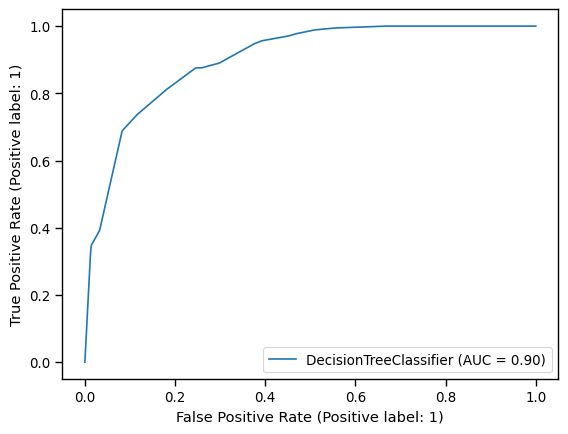

In [48]:
# Specify non-default hyper-parameter values
max_features = 15
max_leaf_nodes = 16 
n_estimators = 50
# Train and test model
good_model = RandomForestClassifier(max_leaf_nodes = max_leaf_nodes,
                                    max_features = max_features, 
                                    n_estimators=n_estimators, ) # create model 
print(good_model) # display model parameters
good_model.fit(X_train, y_train) # train model
pred = good_model.predict(X_test) # predicted output for test examples
print("Results on test data")
acc = accuracy_score(y_test, pred) # accuracy on test examples
prec = precision_score(y_test, pred) # precision on test examples
reca = recall_score(y_test, pred) # recall on test examples
print(f'Test accuracy = {acc: .4f}') # round to 4 decimal places
print(f'Test precision = {prec: .4f}') # round to 4 decimal places
print(f'Test recall = {reca: .4f}') # round to 4 decimal places
print("Classification report:")
print(classification_report(y_test, pred))
print("Confusion matrix (Rows actual, Columns predicted):")
print(pd.DataFrame(confusion_matrix(y_test, pred)))
print('\nROC curve')
svc_disp = RocCurveDisplay.from_estimator(good_model_D, X_test, y_test)

#### Logistic Regression

In [49]:
modelL=LogisticRegression()
modelL.fit(X_train,y_train)
pred_trainL = modelL.predict(X_train)
pred_testL=modelL.predict(X_test)
acc_trainL = accuracy_score(pred_trainL, y_train)
acc_testL = accuracy_score(pred_testL, y_test)
print(f'Training accuracy {acc_trainL: .3f}') 
print(f'Testing accuracy {acc_testL: .3f}')

Training accuracy  0.795
Testing accuracy  0.795


In [50]:
tuned_parameters = [{'C': [10.0, 100.0, 1000.0, 10000.0],
                     'max_iter': [500, 1000]}] # hyperparameters to tune


clfL = GridSearchCV(LogisticRegression(), tuned_parameters, 
                   verbose=1, n_jobs=-1) # grid search model
clfL.fit(X_train,y_train) # evaluate hyper-parameters

print("\nBest parameters found:")
print(clfL.best_params_) # best hyperparameter values

print("\nGrid scores:")
meansL = clfL.cv_results_['mean_test_score'] # mean accuracy with folds
stdsL = clfL.cv_results_['std_test_score'] # standard deviation of accuracies
# for each hyperparameter combination show mean +/- 2 standard-deviations 
for mean, std, params in zip(meansL, stdsL, clfL.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" %(mean, std * 2, params)) 

Fitting 5 folds for each of 8 candidates, totalling 40 fits

Best parameters found:
{'C': 10000.0, 'max_iter': 1000}

Grid scores:
0.832 (+/-0.032) for {'C': 10.0, 'max_iter': 500}
0.832 (+/-0.031) for {'C': 10.0, 'max_iter': 1000}
0.832 (+/-0.032) for {'C': 100.0, 'max_iter': 500}
0.835 (+/-0.028) for {'C': 100.0, 'max_iter': 1000}
0.830 (+/-0.029) for {'C': 1000.0, 'max_iter': 500}
0.836 (+/-0.028) for {'C': 1000.0, 'max_iter': 1000}
0.832 (+/-0.028) for {'C': 10000.0, 'max_iter': 500}
0.836 (+/-0.030) for {'C': 10000.0, 'max_iter': 1000}


LogisticRegression(C=1000, max_iter=1000)
Results on test data
Test accuracy =  0.8412
Test precision =  0.8897
Test recall =  0.8884
Classification report:
              precision    recall  f1-score   support

           0       0.72      0.72      0.72       561
           1       0.89      0.89      0.89      1416

    accuracy                           0.84      1977
   macro avg       0.80      0.81      0.80      1977
weighted avg       0.84      0.84      0.84      1977

Confusion matrix (Rows actual, Columns predicted):
     0     1
0  405   156
1  158  1258

ROC curve


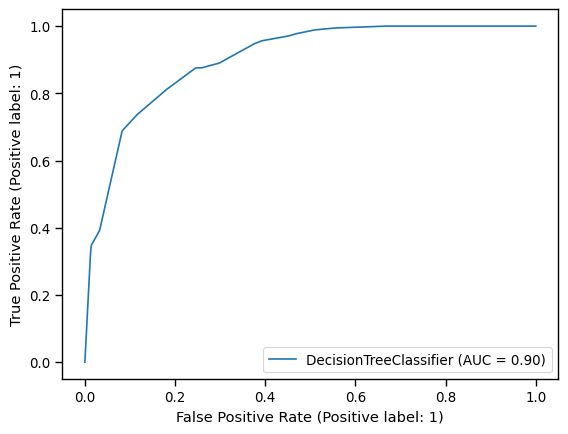

In [51]:
# Specify non-default hyper-parameter values
C = 1000
max_iter = 1000
# Train and test model
good_modelL = LogisticRegression(C = C, max_iter=max_iter) # create model 
print(good_modelL) # display model parameters
good_modelL.fit(X_train,y_train) # train model
predL = good_modelL.predict(X_test) # predicted output for test examples
print("Results on test data")
accL = accuracy_score(y_test, predL) # accuracy on test examples
precL = precision_score(y_test, predL) # precision on test examples
recaL = recall_score(y_test, predL) # recall on test examples
print(f'Test accuracy = {accL: .4f}') # round to 4 decimal places
print(f'Test precision = {precL: .4f}') # round to 4 decimal places
print(f'Test recall = {recaL: .4f}') # round to 4 decimal places
print("Classification report:")
print(classification_report(y_test, predL))
print("Confusion matrix (Rows actual, Columns predicted):")
print(pd.DataFrame(confusion_matrix(y_test, predL)))
print('\nROC curve')
svc_disp = RocCurveDisplay.from_estimator(good_model_D, X_test, y_test)

#### Super Vector Machines

In [52]:
modelsvm=svm.SVC().fit(X_train,y_train)
pred_trainsvm = modelsvm.predict(X_train)
pred_testsvm=modelsvm.predict(X_test)
acc_trainsvm = accuracy_score(pred_trainsvm, y_train)
acc_testsvm = accuracy_score(pred_testsvm, y_test)
print(f'Training accuracy {acc_trainsvm: .3f}') 
print(f'Testing accuracy {acc_testsvm: .3f}')

Training accuracy  0.766
Testing accuracy  0.777


In [53]:
tuned_parameters = [{'kernel':['linear'], 'gamma':[1], 'C':[1]}]
                     # hyperparameters to tune

clfsvm = GridSearchCV(svm.SVC(), tuned_parameters, 
                   verbose=1, n_jobs=-1) # grid search model
clfsvm.fit(X_train,y_train) # evaluate hyper-parameters

print("\nBest parameters found:")
print(clfsvm.best_params_) # best hyperparameter balues

print("\nGrid scores:")
meansvm = clfsvm.cv_results_['mean_test_score'] # mean accuracy with folds
stdsvm = clfsvm.cv_results_['std_test_score'] # standard deviation of accuracies
# for each hyperparameter combination show mean +/- 2 standard-deviations 
for mean, std, params in zip(meansvm, stdsvm, clfsvm.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" %(mean, std * 2, params)) 

Fitting 5 folds for each of 1 candidates, totalling 5 fits

Best parameters found:
{'C': 1, 'gamma': 1, 'kernel': 'linear'}

Grid scores:
0.836 (+/-0.011) for {'C': 1, 'gamma': 1, 'kernel': 'linear'}


SVC(C=1, gamma=0.1, kernel='linear')
Results on test data
Test accuracy =  0.8417
Test precision =  0.8607
Test recall =  0.9294
Classification report:
              precision    recall  f1-score   support

           0       0.78      0.62      0.69       561
           1       0.86      0.93      0.89      1416

    accuracy                           0.84      1977
   macro avg       0.82      0.77      0.79      1977
weighted avg       0.84      0.84      0.84      1977

Confusion matrix (Rows actual, Columns predicted):
     0     1
0  348   213
1  100  1316

ROC curve


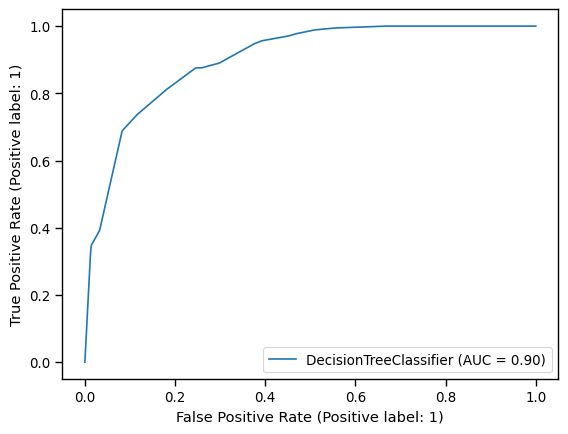

In [58]:
# Specify non-default hyper-parameter values
C = 1 # algorithm name
kernel = 'linear'# kernel type
gamma =  0.1 # kernel parameter
# Train and test model
good_modelsvm = svm.SVC(C=C, kernel=kernel, 
                                  gamma=gamma) # create model 
print(good_modelsvm) # display model parameters
good_modelsvm.fit(X_train,y_train) # train model
predsvm = good_modelsvm.predict(X_test) # predicted output for test examples
print("Results on test data")
accsvm = accuracy_score(y_test, predsvm) # accuracy on test examples
precsvm = precision_score(y_test, predsvm) # precision on test examples
recasvm = recall_score(y_test, predsvm) # recall on test examples
print(f'Test accuracy = {accsvm: .4f}') # round to 4 decimal places
print(f'Test precision = {precsvm: .4f}') # round to 4 decimal places
print(f'Test recall = {recasvm: .4f}') # round to 4 decimal places
print("Classification report:")
print(classification_report(y_test, predsvm))
print("Confusion matrix (Rows actual, Columns predicted):")
print(pd.DataFrame(confusion_matrix(y_test, predsvm)))
print('\nROC curve')
svc_disp = RocCurveDisplay.from_estimator(good_model_D, X_test, y_test)

### GETTING COMBINED RESULTS FROM THE TUNED MODELS

In [59]:
models_opt = []

models_opt.append(('Logistic Regression', LogisticRegression(solver='liblinear',C = 1000, max_iter=1000, random_state = 0)))
models_opt.append(('SVC', SVC(C=1, kernel = 'linear', gamma=1, random_state = 0)))
models_opt.append(('Kernel SVM', SVC(C=1, kernel = 'rbf', gamma=1, random_state = 0)))
models_opt.append(('Gaussian NB', GaussianNB()))
models_opt.append(('Decision Tree Classifier', DecisionTreeClassifier(criterion = 'gini', max_leaf_nodes=19, random_state = 0)))
models_opt.append(('Random Forest', RandomForestClassifier(max_leaf_nodes = 16,max_features = 15, 
                                                           n_estimators = 50,criterion = 'entropy', random_state = 0)))

In [60]:
acc_results_opt =[]
auc_results_opt =[]
pre_results_opt =[]
f1_results_opt =[]
names_opt = []

result_col_opt = ["Algorithm", "ROC AUC", "Accuracy", 'Precision', 'F1 Scores']
model_results_opt = pd.DataFrame(columns = result_col_opt)

i=0
# K- fold cross validation

for name, model in models:
    names_opt.append(name)
    kfold = model_selection.KFold(n_splits=10)
    
    cv_acc_results_opt = model_selection.cross_val_score(model, X_train, y_train, 
                    cv = kfold, scoring="accuracy")
    cv_auc_results_opt = model_selection.cross_val_score(model, X_train, y_train,
                    cv = kfold, scoring="roc_auc")
    cv_pre_results_opt = model_selection.cross_val_score(model, X_train, y_train,
                    cv = kfold, scoring="precision")
    cv_f1_results_opt = model_selection.cross_val_score(model, X_train, y_train,
                    cv = kfold, scoring="f1")
    acc_results_opt.append(cv_acc_results_opt)
    auc_results_opt.append(cv_auc_results_opt)
    pre_results_opt.append(cv_pre_results_opt)
    f1_results_opt.append(cv_f1_results_opt)
    model_results_opt.loc[i] = [name, 
                           round(cv_auc_results_opt.mean()*100,2),
                           round(cv_acc_results_opt.mean()*100,2),
                           round(cv_pre_results_opt.mean()*100,2),
                           round(cv_f1_results_opt.mean()*100,2)]
    i+=1

model_results_opt.sort_values(by = ['ROC AUC'], ascending=False)

,Algorithm,ROC AUC,Accuracy,Precision,F1 Scores
3,Random Forest,92.21,86.58,88.10,91.11
2,Gaussian NB,86.27,76.63,91.12,82.04
0,Logistic Regression,85.80,79.97,84.58,86.28
4,Decision Tree Classifier,77.66,81.27,87.09,87.01
1,Kernel SVM,71.13,76.63,79.42,84.78


### Testing model performances on Test Data

In [61]:
acc_results_opt =[]
auc_results_opt =[]
pre_results_opt =[]
f1_results_opt =[]
names_opt = []

result_col_opt = ["Algorithm", "ROC AUC", "Accuracy", 'Precision', 'F1 Scores']
model_results_opt = pd.DataFrame(columns = result_col_opt)

i=0
# K- fold cross validation

for name, model in models:
    names_opt.append(name)
    kfold = model_selection.KFold(n_splits=10)
    
    cv_acc_results_opt = model_selection.cross_val_score(model, X_test, y_test, 
                    cv = kfold, scoring="accuracy")
    cv_auc_results_opt = model_selection.cross_val_score(model, X_test, y_test,
                    cv = kfold, scoring="roc_auc")
    cv_pre_results_opt = model_selection.cross_val_score(model, X_test, y_test,
                    cv = kfold, scoring="precision")
    cv_f1_results_opt = model_selection.cross_val_score(model, X_test, y_test,
                    cv = kfold, scoring="f1")
    acc_results_opt.append(cv_acc_results_opt)
    auc_results_opt.append(cv_auc_results_opt)
    pre_results_opt.append(cv_pre_results_opt)
    f1_results_opt.append(cv_f1_results_opt)
    model_results_opt.loc[i] = [name, 
                           round(cv_auc_results_opt.mean()*100,2),
                           round(cv_acc_results_opt.mean()*100,2),
                           round(cv_pre_results_opt.mean()*100,2),
                           round(cv_f1_results_opt.mean()*100,2)]
    i+=1

model_results_opt.sort_values(by = ['ROC AUC'], ascending=False)

,Algorithm,ROC AUC,Accuracy,Precision,F1 Scores
3,Random Forest,91.80,86.29,87.43,90.77
2,Gaussian NB,86.00,76.02,90.33,81.63
0,Logistic Regression,85.08,79.26,83.79,85.87
4,Decision Tree Classifier,79.04,82.05,88.31,87.05
1,Kernel SVM,72.75,77.19,80.88,84.87
